# **Census tract-level PM2.5 analysis of Ontario city, San Berdarnido, 2015** 
Author: Yu-Chen Chu

Group Members: Georgie Suico, Matthews Cribioli, Alejandra Gutierrez

Description: This is the PM2.5 analysis of Ontario city, San Berdarnido in 2015. The data source is from Centers for Disease Control and Prevention (CDC). I plan to analyze the average amount of PM2.5 in each census tract in Ontario city of year 2005, 2010, and 2015. The change of the amount of PM2.5 may relate to the location and spread of warehouses.

Source Link: https://data.cdc.gov/browse/select_dataset?tags=pm2.5

## Basic libraries and other useful import

In [1]:
# libraries
import pandas as pd
import geopandas as gpd

# to give more power to your figures (plots)
import matplotlib.pyplot as plt

import contextily as ctx

# for interactive plots
import plotly.express as px

# to import open data
from sodapy import Socrata

In [2]:
# Import Data
df_06071_2015 = pd.read_csv('Daily_Census_Tract-Level_PM2.5_Concentrations__2015_San Bernado.csv')
df_06071_2015


,year,date,statefips,countyfips,ctfips,latitude,longitude,DS_PM_pred,DS_PM_stdd
0,2015,01JAN2015,6,71,6071000116,33.92290,-117.70162,34.2535,15.1588
1,2015,01JAN2015,6,71,6071000111,33.95165,-117.76035,33.4625,14.6576
2,2015,01JAN2015,6,71,6071000115,33.95396,-117.66935,34.5059,14.9012
3,2015,01JAN2015,6,71,6071001903,33.96728,-117.62242,34.2461,14.2192
4,2015,01JAN2015,6,71,6071000113,33.97096,-117.70341,33.7835,14.7224
...,...,...,...,...,...,...,...,...,...
134680,2015,31DEC2015,6,71,6071011900,34.94399,-117.07542,3.5268,2.6737
134681,2015,31DEC2015,6,71,6071011600,35.04700,-117.29282,3.6661,2.8510
134682,2015,31DEC2015,6,71,6071010300,35.16361,-115.88875,3.8300,3.0081
134683,2015,31DEC2015,6,71,6071025000,35.39228,-116.62721,2.6694,2.1088


In [3]:
# See the info of df_06071_2015
df_06071_2015.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 134685 entries, 0 to 134684
Data columns (total 9 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   year        134685 non-null  int64  
 1   date        134685 non-null  object 
 2   statefips   134685 non-null  int64  
 3   countyfips  134685 non-null  int64  
 4   ctfips      134685 non-null  int64  
 5   latitude    134685 non-null  float64
 6   longitude   134685 non-null  float64
 7   DS_PM_pred  134685 non-null  float64
 8   DS_PM_stdd  134685 non-null  float64
dtypes: float64(4), int64(4), object(1)
memory usage: 9.2+ MB


Statefips, countyfips, and ctfips are all intergers, which is the reason that those fips code lack "0" in front of them. Thus, I have to convert them to "string".

In [4]:
# Re-import the file and convert "int" to "str"
df_06071_2015 = pd.read_csv(
    'Daily_Census_Tract-Level_PM2.5_Concentrations__2015_San Bernado.csv',
    dtype=
    {
        'statefips':str,
        'countyfips':str,
        'ctfips': str
    }
)

# See the first two rows
df_06071_2015.head(2)

,year,date,statefips,countyfips,ctfips,latitude,longitude,DS_PM_pred,DS_PM_stdd
0,2015,01JAN2015,06,071,06071000116,33.92290,-117.70162,34.2535,15.1588
1,2015,01JAN2015,06,071,06071000111,33.95165,-117.76035,33.4625,14.6576


In [5]:
df_06071_2015.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 134685 entries, 0 to 134684
Data columns (total 9 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   year        134685 non-null  int64  
 1   date        134685 non-null  object 
 2   statefips   134685 non-null  object 
 3   countyfips  134685 non-null  object 
 4   ctfips      134685 non-null  object 
 5   latitude    134685 non-null  float64
 6   longitude   134685 non-null  float64
 7   DS_PM_pred  134685 non-null  float64
 8   DS_PM_stdd  134685 non-null  float64
dtypes: float64(4), int64(1), object(4)
memory usage: 9.2+ MB


In [6]:
# See the unique value of the census tract fips code
df_ctfips = df_06071_2015['ctfips'].unique()
df_ctfips

array(['06071000116', '06071000111', '06071000115', '06071001903',
       '06071000113', '06071000108', '06071000109', '06071000117',
       '06071000118', '06071012200', '06071000107', '06071000105',
       '06071000504', '06071000104', '06071001906', '06071001901',
       '06071001905', '06071008709', '06071008708', '06071000401',
       '06071000503', '06071000606', '06071000605', '06071000103',
       '06071008500', '06071008704', '06071000604', '06071002206',
       '06071001809', '06071001804', '06071001703', '06071001806',
       '06071001808', '06071007106', '06071008710', '06071000501',
       '06071008705', '06071007302', '06071007105', '06071008302',
       '06071000603', '06071007104', '06071001810', '06071008800',
       '06071001704', '06071002604', '06071008703', '06071007107',
       '06071000403', '06071002607', '06071000404', '06071001803',
       '06071007109', '06071008301', '06071002606', '06071002602',
       '06071001812', '06071008706', '06071004003', '060710017

## Group the values  

Since the PM2.5 data was collected daily, there are many repitetive rows of the same census tracts. Thus, I group the rows with the same ctfips to condense the data.  

In [7]:
# Group rows with the same ctfips

df_06071_2015_grp = df_06071_2015.groupby(['ctfips'])
df_06071_2015_grp.value_counts()

ctfips       year  date       statefips  countyfips  latitude  longitude   DS_PM_pred  DS_PM_stdd
06071000103  2015  01APR2015  06         071         34.01563  -117.75255  13.4005     5.48710       1
                   01AUG2015  06         071         34.01563  -117.75255  12.7637     3.73120       1
                   31JUL2015  06         071         34.01563  -117.75255  16.0383     7.30330       1
                   31DEC2015  06         071         34.01563  -117.75255  9.6945      5.17710       1
                   31AUG2015  06         071         34.01563  -117.75255  11.1931     2.80730       1
                                                                                                    ..
06071980200  2015  01OCT2015  06         071         34.58524  -117.37188  8.0045      5.18090       1
                   01NOV2015  06         071         34.58524  -117.37188  8.3532      5.49320       1
                   01MAY2015  06         071         34.58524  -117.37188  5.9

In [8]:
# Count the rows after groupby

df_06071_2015_grp['ctfips'].value_counts() #condense 134685 rows to 369 rows

ctfips       ctfips     
06071000103  06071000103    365
06071000104  06071000104    365
06071000105  06071000105    365
06071000107  06071000107    365
06071000108  06071000108    365
                           ... 
06071025000  06071025000    365
06071025100  06071025100    365
06071940100  06071940100    365
06071980100  06071980100    365
06071980200  06071980200    365
Name: ctfips, Length: 369, dtype: int64

## Data Aggregation  

I do the basic statistics of 'DS_PM_pred' and 'DS_PM_stdd' these two columns for further analysis.

In [9]:
# Aggregate the data
df_PM_2015 = df_06071_2015_grp['DS_PM_pred','DS_PM_stdd'].agg(['count','median','mean','max','min'])
df_PM_2015

/tmp/ipykernel_7231/2187821024.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  df_PM_2015 = df_06071_2015_grp['DS_PM_pred','DS_PM_stdd'].agg(['count','median','mean','max','min'])


DS_PM_pred                                       DS_PM_stdd  \
                 count   median       mean      max      min      count   
ctfips                                                                    
06071000103        365  11.1931  12.565185  49.9988  2.98630        365   
06071000104        365  11.2450  12.641381  51.5793  3.02110        365   
06071000105        365  11.3081  12.759428  53.9022  3.03040        365   
06071000107        365  11.3386  12.877081  55.1246  3.00170        365   
06071000108        365  11.3728  12.847559  57.5513  3.05540        365   
...                ...      ...        ...      ...      ...        ...   
06071025000        365   4.8981   5.286368  22.4341  0.76974        365   
06071025100        365   4.8349   4.948126  12.6053  0.80489        365   
06071940100        365   4.7098   4.837616  10.9053  0.68116        365   
06071980100        365  10.0631  10.556667  30.9917  1.79810        365   
06071980200        365   7.4851   7.643472  19.0268  1.59900        365   

                                                 
             median      mean      max      min  
ctfips                                           
06071000103  4.6147  5.303213  19.8897  0.87609  
06071000104  4.6748  5.338625  20.2759  0.90715  
06071000105  4.6690  5.377807  21.0182  0.89511  
06071000107  4.7152  5.426830  21.3526  0.95280  
06071000108  4.6647  5.418145  22.6953  0.90653  
...             ...       ...      ...      ...  
06071025000  2.8044  2.988793  13.0019  0.61041  
06071025100  2.7250  2.907571   8.0551  0.62478  
06071940100  2.6113  2.844786   8.2919  0.50224  
06071980100  4.1642  4.595959  13.3895  0.70189  
06071980200  3.7290  3.863492  10.9898  0.59160  

[369 rows x 10 columns]

## Join two dataframes

It is obvious that current dataframe lack geo info. Thus, I subtract the data with only geo info and merge two dataframes together. 

In [10]:
# Create a new dataframe with only fips code and lon and lat

df_06071_2015_geo = df_06071_2015[['ctfips','latitude','longitude']]
df_2015_geo = df_06071_2015_geo.value_counts().reset_index()
df_2015_geo

,ctfips,latitude,longitude,0
0,06071000103,34.01563,-117.75255,365
1,06071008301,34.04220,-117.20259,365
2,06071008703,34.03702,-116.98599,365
3,06071008602,34.07160,-117.08838,365
4,06071008601,34.06271,-117.13024,365
...,...,...,...,...
364,06071002401,34.09561,-117.48002,365
365,06071002307,34.11765,-117.41626,365
366,06071002306,34.12817,-117.41555,365
367,06071002305,34.11394,-117.47114,365


In [11]:
# create a new dataframe based on the join

tracts_PM_2015 = df_PM_2015.merge(df_2015_geo,on="ctfips")
tracts_PM_2015

/tmp/ipykernel_7231/904771213.py:3: FutureWarning: merging between different levels is deprecated and will be removed in a future version. (2 levels on the left, 1 on the right)
  tracts_PM_2015 = df_PM_2015.merge(df_2015_geo,on="ctfips")


,ctfips,"(DS_PM_pred, count)","(DS_PM_pred, median)","(DS_PM_pred, mean)","(DS_PM_pred, max)","(DS_PM_pred, min)","(DS_PM_stdd, count)","(DS_PM_stdd, median)","(DS_PM_stdd, mean)","(DS_PM_stdd, max)","(DS_PM_stdd, min)",latitude,longitude,0
0,06071000103,365,11.1931,12.565185,49.9988,2.98630,365,4.6147,5.303213,19.8897,0.87609,34.01563,-117.75255,365
1,06071000104,365,11.2450,12.641381,51.5793,3.02110,365,4.6748,5.338625,20.2759,0.90715,34.00594,-117.75116,365
2,06071000105,365,11.3081,12.759428,53.9022,3.03040,365,4.6690,5.377807,21.0182,0.89511,33.99351,-117.73910,365
3,06071000107,365,11.3386,12.877081,55.1246,3.00170,365,4.7152,5.426830,21.3526,0.95280,33.98608,-117.72243,365
4,06071000108,365,11.3728,12.847559,57.5513,3.05540,365,4.6647,5.418145,22.6953,0.90653,33.97150,-117.74024,365
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
364,06071025000,365,4.8981,5.286368,22.4341,0.76974,365,2.8044,2.988793,13.0019,0.61041,35.39228,-116.62721,365
365,06071025100,365,4.8349,4.948126,12.6053,0.80489,365,2.7250,2.907571,8.0551,0.62478,34.50440,-114.81338,365
366,06071940100,365,4.7098,4.837616,10.9053,0.68116,365,2.6113,2.844786,8.2919,0.50224,34.18517,-114.30980,365
367,06071980100,365,10.0631,10.556667,30.9917,1.79810,365,4.1642,4.595959,13.3895,0.70189,34.09798,-117.23980,365


In [12]:
# convert lon and lat to points

tracts_PM_2015_geo = gpd.GeoDataFrame(tracts_PM_2015, geometry = gpd.points_from_xy(tracts_PM_2015.longitude, tracts_PM_2015.latitude))
tracts_PM_2015_geo.head() 

,ctfips,"(DS_PM_pred, count)","(DS_PM_pred, median)","(DS_PM_pred, mean)","(DS_PM_pred, max)","(DS_PM_pred, min)","(DS_PM_stdd, count)","(DS_PM_stdd, median)","(DS_PM_stdd, mean)","(DS_PM_stdd, max)","(DS_PM_stdd, min)",latitude,longitude,0,geometry
0,06071000103,365,11.1931,12.565185,49.9988,2.9863,365,4.6147,5.303213,19.8897,0.87609,34.01563,-117.75255,365,POINT (-117.75255 34.01563)
1,06071000104,365,11.2450,12.641381,51.5793,3.0211,365,4.6748,5.338625,20.2759,0.90715,34.00594,-117.75116,365,POINT (-117.75116 34.00594)
2,06071000105,365,11.3081,12.759428,53.9022,3.0304,365,4.6690,5.377807,21.0182,0.89511,33.99351,-117.73910,365,POINT (-117.73910 33.99351)
3,06071000107,365,11.3386,12.877081,55.1246,3.0017,365,4.7152,5.426830,21.3526,0.95280,33.98608,-117.72243,365,POINT (-117.72243 33.98608)
4,06071000108,365,11.3728,12.847559,57.5513,3.0554,365,4.6647,5.418145,22.6953,0.90653,33.97150,-117.74024,365,POINT (-117.74024 33.97150)


## Change column title and clean unwanted columns

Make it easier to read and make the dataframe cleaner

In [13]:
# change column title

tracts_PM_2015_geo.columns = ['FIPS',
'PM2.5_pred_count',
'PM2.5_pred_median',
'PM2.5_pred_mean',
'PM2.5_pred_max',
'PM2.5_pred_min',
'PM2.5_stdd_count',
'PM2.5_stdd_median',
'PM2.5_stdd_mean',
'PM2.5_stdd_max',
'PM2.5_stdd_min',
'latitude',
'longitude',    
'0',
'geometry'] 

tracts_PM_2015_geo

,FIPS,PM2.5_pred_count,PM2.5_pred_median,PM2.5_pred_mean,PM2.5_pred_max,PM2.5_pred_min,PM2.5_stdd_count,PM2.5_stdd_median,PM2.5_stdd_mean,PM2.5_stdd_max,PM2.5_stdd_min,latitude,longitude,0,geometry
0,06071000103,365,11.1931,12.565185,49.9988,2.98630,365,4.6147,5.303213,19.8897,0.87609,34.01563,-117.75255,365,POINT (-117.75255 34.01563)
1,06071000104,365,11.2450,12.641381,51.5793,3.02110,365,4.6748,5.338625,20.2759,0.90715,34.00594,-117.75116,365,POINT (-117.75116 34.00594)
2,06071000105,365,11.3081,12.759428,53.9022,3.03040,365,4.6690,5.377807,21.0182,0.89511,33.99351,-117.73910,365,POINT (-117.73910 33.99351)
3,06071000107,365,11.3386,12.877081,55.1246,3.00170,365,4.7152,5.426830,21.3526,0.95280,33.98608,-117.72243,365,POINT (-117.72243 33.98608)
4,06071000108,365,11.3728,12.847559,57.5513,3.05540,365,4.6647,5.418145,22.6953,0.90653,33.97150,-117.74024,365,POINT (-117.74024 33.97150)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
364,06071025000,365,4.8981,5.286368,22.4341,0.76974,365,2.8044,2.988793,13.0019,0.61041,35.39228,-116.62721,365,POINT (-116.62721 35.39228)
365,06071025100,365,4.8349,4.948126,12.6053,0.80489,365,2.7250,2.907571,8.0551,0.62478,34.50440,-114.81338,365,POINT (-114.81338 34.50440)
366,06071940100,365,4.7098,4.837616,10.9053,0.68116,365,2.6113,2.844786,8.2919,0.50224,34.18517,-114.30980,365,POINT (-114.30980 34.18517)
367,06071980100,365,10.0631,10.556667,30.9917,1.79810,365,4.1642,4.595959,13.3895,0.70189,34.09798,-117.23980,365,POINT (-117.23980 34.09798)


## Subset Data

Subset the data of Ontario city

In [14]:
# Store the census tracts fips code of Ontario city in options
options = ['06071001903', '06071001906', '06071001905', '06071001703', '06071001804','06071001806','06071001808',
           '06071001809','06071002206','06071012700','06071001803','06071001810','06071001704','06071001702','06071001707',
           '06071001812','06071001813','06071001600','06071001001','06071001002','06071001101','06071001400','06071001501',
           '06071001503','06071001104','06071001706','06071000603','06071000304','06071001103','06071001200','06071001310',
           '06071001309','06071001305','06071001308','06071001312','06071002109','06071001504','06071001307'] 

ontario = tracts_PM_2015_geo[tracts_PM_2015_geo['FIPS'].isin(options)] 

ontario

,FIPS,PM2.5_pred_count,PM2.5_pred_median,PM2.5_pred_mean,PM2.5_pred_max,PM2.5_pred_min,PM2.5_stdd_count,PM2.5_stdd_median,PM2.5_stdd_mean,PM2.5_stdd_max,PM2.5_stdd_min,latitude,longitude,0,geometry
19,06071000304,365,11.1260,12.316357,43.8492,2.6580,365,4.5829,5.146502,16.5403,0.88907,34.05364,-117.69411,365,POINT (-117.69411 34.05364)
26,06071000603,365,11.4398,12.636730,48.1934,2.7456,365,4.6248,5.237105,18.3885,0.91666,34.02996,-117.68298,365,POINT (-117.68298 34.02996)
49,06071001001,365,10.8126,11.962123,39.1250,2.4986,365,4.4891,5.008148,15.4792,0.90655,34.08081,-117.67549,365,POINT (-117.67549 34.08081)
50,06071001002,365,10.9828,12.151449,40.6327,2.5590,365,4.4766,5.064263,15.6886,0.87447,34.06876,-117.67545,365,POINT (-117.67545 34.06876)
51,06071001101,365,11.0088,12.208460,41.6324,2.5302,365,4.4884,5.048720,16.0724,0.90414,34.06607,-117.66300,365,POINT (-117.66300 34.06607)
52,06071001103,365,10.8802,12.029346,38.9153,2.4351,365,4.4926,5.013548,15.1603,0.87338,34.07890,-117.65620,365,POINT (-117.65620 34.07890)
53,06071001104,365,10.8686,12.036493,38.8176,2.4747,365,4.4844,5.027296,15.8209,0.90344,34.07812,-117.66543,365,POINT (-117.66543 34.07812)
54,06071001200,365,10.9287,12.044674,38.4939,2.4110,365,4.4354,5.003354,15.0933,0.88376,34.07951,-117.64617,365,POINT (-117.64617 34.07951)
55,06071001305,365,11.0153,11.978788,37.2699,2.3462,365,4.4437,4.960359,14.1479,0.84747,34.08452,-117.62799,365,POINT (-117.62799 34.08452)
56,06071001307,365,10.9735,11.933476,36.7544,2.2771,365,4.3797,4.950159,14.4147,0.83082,34.08852,-117.61986,365,POINT (-117.61986 34.08852)


In [15]:
ontario.info() # Only 38 rows right now. Great!

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 38 entries, 19 to 363
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   FIPS               38 non-null     object  
 1   PM2.5_pred_count   38 non-null     int64   
 2   PM2.5_pred_median  38 non-null     float64 
 3   PM2.5_pred_mean    38 non-null     float64 
 4   PM2.5_pred_max     38 non-null     float64 
 5   PM2.5_pred_min     38 non-null     float64 
 6   PM2.5_stdd_count   38 non-null     int64   
 7   PM2.5_stdd_median  38 non-null     float64 
 8   PM2.5_stdd_mean    38 non-null     float64 
 9   PM2.5_stdd_max     38 non-null     float64 
 10  PM2.5_stdd_min     38 non-null     float64 
 11  latitude           38 non-null     float64 
 12  longitude          38 non-null     float64 
 13  0                  38 non-null     int64   
 14  geometry           38 non-null     geometry
dtypes: float64(10), geometry(1), int64(3), object(1)


## Simple plots

Make some simple plots based on current data. Focus on the mean daily PM2.5 first.

<AxesSubplot: ylabel='Frequency'>

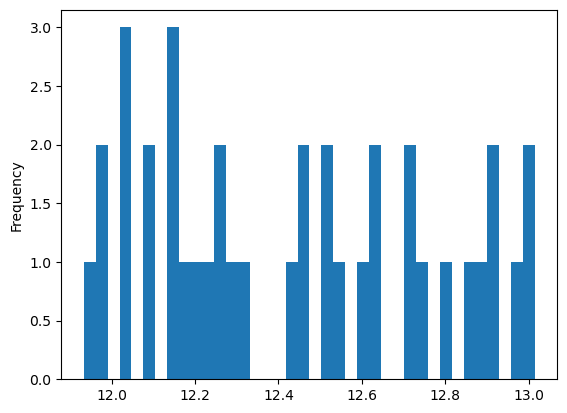

In [16]:
# Hist bar: see the distribution
ontario['PM2.5_pred_mean'].plot.hist(bins=38) # Does not look good

<AxesSubplot: xlabel='PM2.5_pred_mean', ylabel='PM2.5_pred_median'>

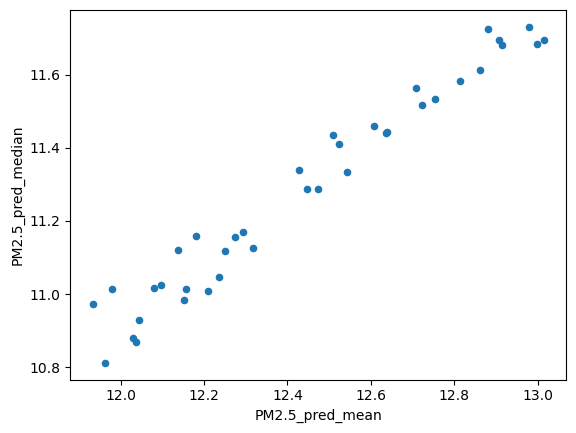

In [17]:
# Scatter plot: see the relation between mean and median
ontario.plot.scatter(x='PM2.5_pred_mean',y='PM2.5_pred_median')

## Sort Data

Sort the mean PM2.5 to see the top ten and last ten census tracts.

<AxesSubplot: title={'center': 'Top 10 Census Tracts with Highest PM2.5 in Ontario City in 2015'}, ylabel='FIPS'>

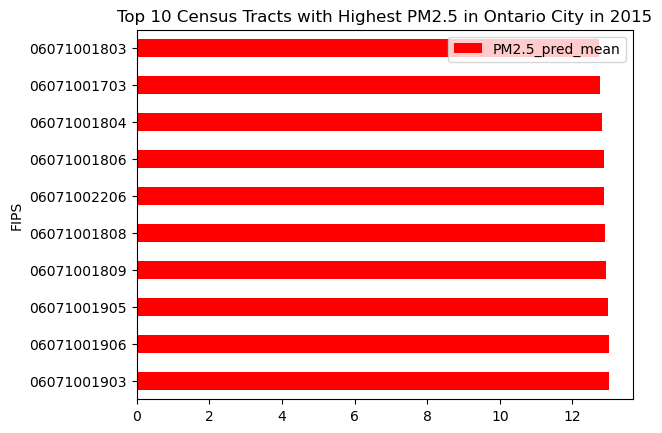

In [18]:
# Top ten 
ontario_sortedtop = ontario.sort_values(by='PM2.5_pred_mean',ascending = False)

ontario_sortedtop.head(10).plot.barh(x='FIPS',  # barh turns the plot direction 
                            y='PM2.5_pred_mean', 
                            title='Top 10 Census Tracts with Highest PM2.5 in Ontario City in 2015',
                            color='red')

<AxesSubplot: title={'center': 'Bottom 10 Census Tracts with Lowest PM2.5 in Ontario City in 2015'}, ylabel='FIPS'>

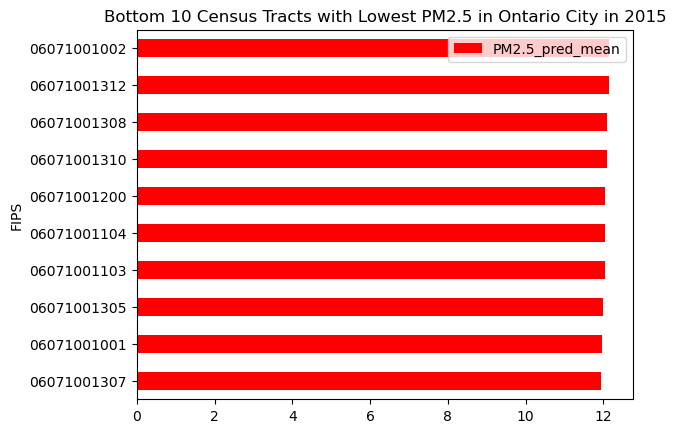

In [19]:
# Bottom ten 
ontario_sortedbottom = ontario.sort_values(by='PM2.5_pred_mean',ascending = True)

ontario_sortedbottom.head(10).plot.barh(x='FIPS',  # barh turns the plot direction 
                            y='PM2.5_pred_mean', 
                            title='Bottom 10 Census Tracts with Lowest PM2.5 in Ontario City in 2015',
                            color='red')
# Does not look much different

## Using plotly to make some maps

Use plotly to make interactive plots that tell more info

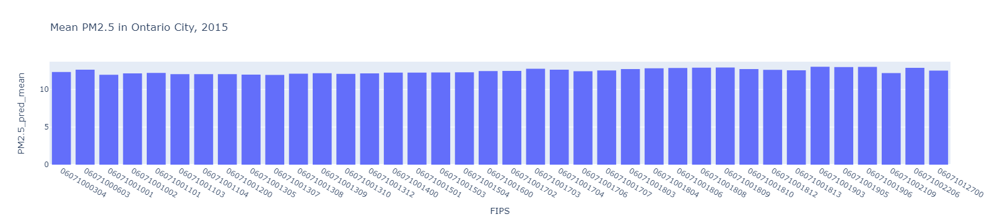

In [20]:
# a simple bar chart, putting census tracts on the x-axis
fig = px.bar(ontario,
       x='FIPS',
       y='PM2.5_pred_mean',
       title='Mean PM2.5 in Ontario City, 2015'
      )

# get rid of white lines inside the bars
fig.update_traces(marker_line_width=0)

# show the figure
fig.show()

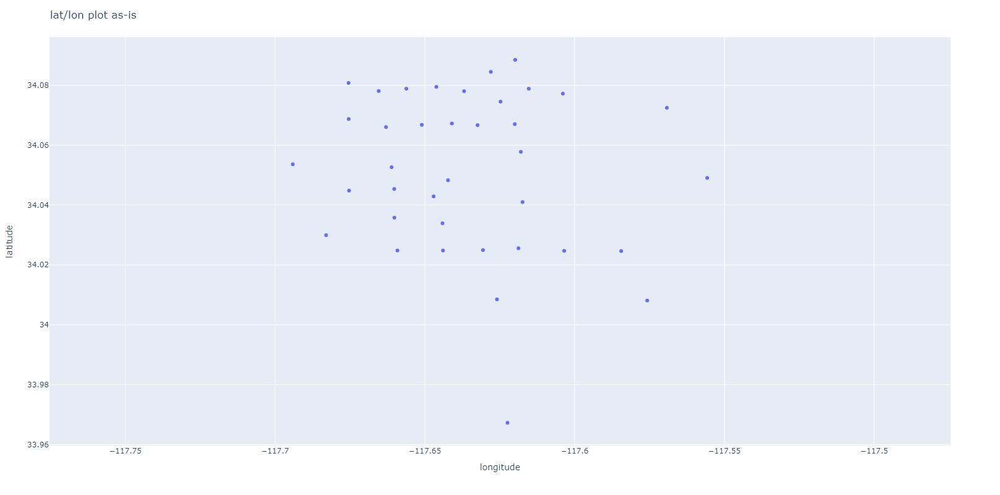

In [21]:
# scatter plot woth lon and lat
fig = px.scatter(ontario,
           x='longitude',
           y='latitude'
)

# options on the layout
fig.update_layout(
    width = 800,
    height = 800,
    title = "lat/lon plot as-is"
)

# make it a square grid
fig.update_yaxes(
    scaleanchor = "x",
    scaleratio = 1,
)

fig.show()

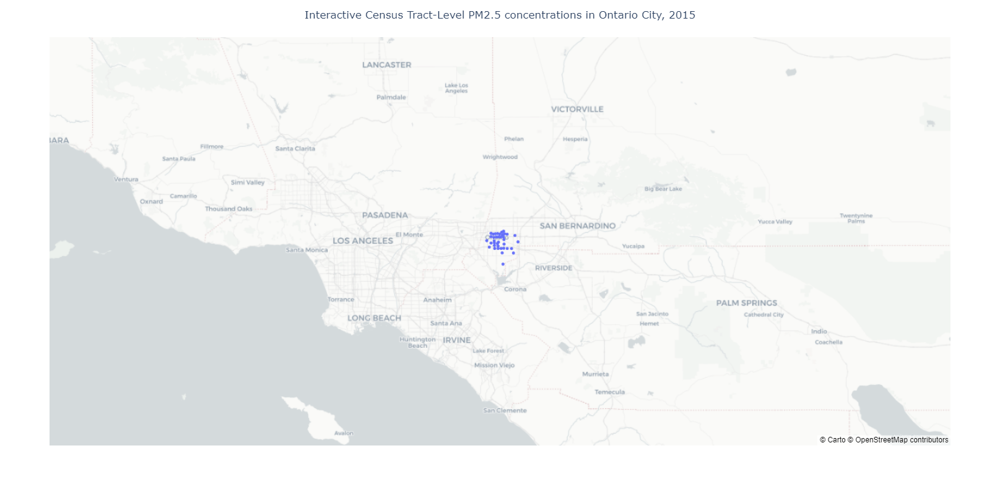

In [22]:
fig = px.scatter_mapbox(ontario,
           lon='longitude',
           lat ='latitude',
           mapbox_style="carto-positron")

# options on the layout
fig.update_layout(
    width = 800,
    height = 800,
    title = "Interactive Census Tract-Level PM2.5 concentrations in Ontario City, 2015",
    title_x=0.5 # aligns title to center
)

fig.show()

The dots on the map only show approximately the location of census tracts, which cannot really deonstrate the entire census tract region and the level of PM2.5 concentration. The lon and lat infos have to be converted into region which shows the level with different colors.

## Simple Maps

Do some simple maps based on current info.

In [23]:
# Subtract data we need first to make the dataframes cleaner

ontario_mini = ontario[['FIPS',
'PM2.5_pred_count',
'PM2.5_pred_median',
'PM2.5_pred_mean',
'PM2.5_pred_max',
'PM2.5_pred_min',
'latitude',
'longitude',    
'geometry']] 

ontario_mini

,FIPS,PM2.5_pred_count,PM2.5_pred_median,PM2.5_pred_mean,PM2.5_pred_max,PM2.5_pred_min,latitude,longitude,geometry
19,06071000304,365,11.1260,12.316357,43.8492,2.6580,34.05364,-117.69411,POINT (-117.69411 34.05364)
26,06071000603,365,11.4398,12.636730,48.1934,2.7456,34.02996,-117.68298,POINT (-117.68298 34.02996)
49,06071001001,365,10.8126,11.962123,39.1250,2.4986,34.08081,-117.67549,POINT (-117.67549 34.08081)
50,06071001002,365,10.9828,12.151449,40.6327,2.5590,34.06876,-117.67545,POINT (-117.67545 34.06876)
51,06071001101,365,11.0088,12.208460,41.6324,2.5302,34.06607,-117.66300,POINT (-117.66300 34.06607)
52,06071001103,365,10.8802,12.029346,38.9153,2.4351,34.07890,-117.65620,POINT (-117.65620 34.07890)
53,06071001104,365,10.8686,12.036493,38.8176,2.4747,34.07812,-117.66543,POINT (-117.66543 34.07812)
54,06071001200,365,10.9287,12.044674,38.4939,2.4110,34.07951,-117.64617,POINT (-117.64617 34.07951)
55,06071001305,365,11.0153,11.978788,37.2699,2.3462,34.08452,-117.62799,POINT (-117.62799 34.08452)
56,06071001307,365,10.9735,11.933476,36.7544,2.2771,34.08852,-117.61986,POINT (-117.61986 34.08852)


### From dataframe (df) to geodataframe (gdf)
Since the data I bring into a jupyter notebook `csv` format and contains separate columns for latitude and longitude, I have to convert the data into a geodataframe for mapping purposes.

Things to note: If the data has latitude and longitude coordinates, it is a **[geographic coordinate system (GCS)](https://en.wikipedia.org/wiki/World_Geodetic_System)** with a crs code `epsg:4326`.

In [24]:
# convert df to gdf
# since data is in lat/lon's assign the crs to WGS84 (epsg:4326)
g_ontario_mini = gpd.GeoDataFrame(ontario_mini, 
                       crs='epsg:4326',
                       geometry=gpd.points_from_xy(ontario_mini.longitude, ontario_mini.latitude))

In [25]:
# output the data's projection
g_ontario_mini.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

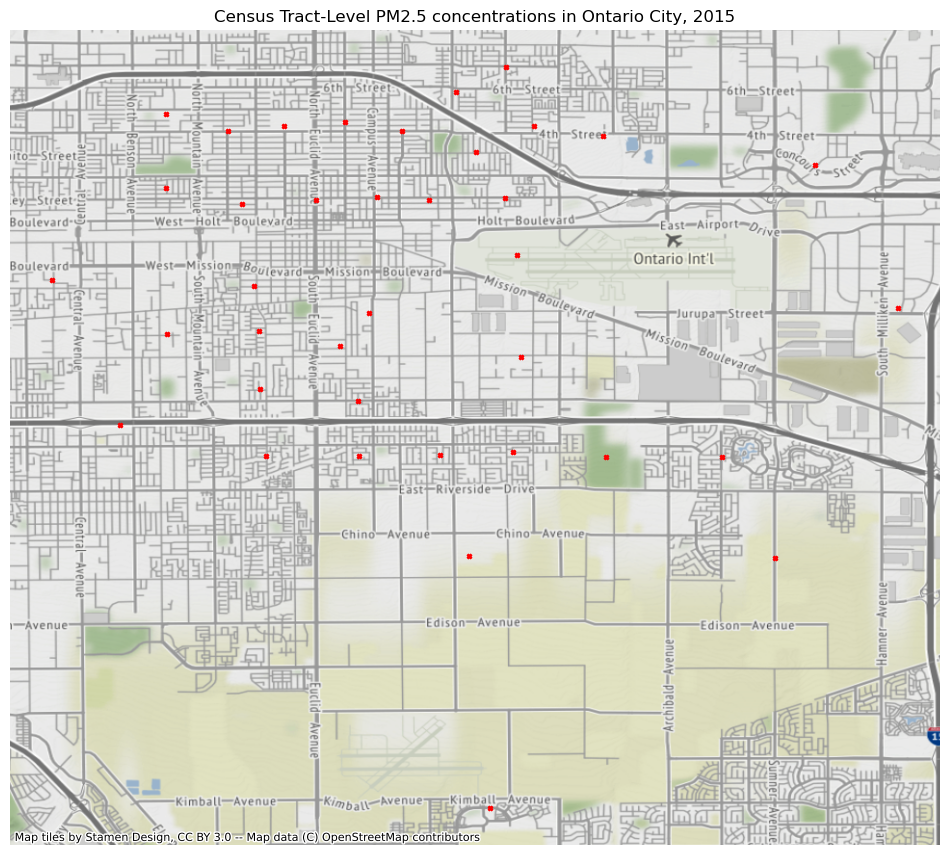

In [26]:
# start the plot
fig, ax = plt.subplots(figsize=(12,12))

# add the data options
g_ontario_mini.plot(ax=ax, 
        marker='X',
        markersize=10,
        color='red')

# turn the axes off
ax.axis('off')

# give it a title
ax.set_title('Census Tract-Level PM2.5 concentrations in Ontario City, 2015')

# add a basemap
ctx.add_basemap(ax, crs=4326) # note that we must specify the projection here (crs)

## Make Cencus Tract data and interactive map of Ontario city

Before visualizing the PM2.5 concentration on map, I have to make the census tracts and interactive map of Ontario city first based on the city boundary.

Data Source: https://data.ca.gov/dataset/ca-geographic-boundaries/resource/436fc714-831c-4070-b44b-b06dcde6bf18


In [27]:
# import libraries and folium
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium

In [28]:
# Import the city boundary of CA. The data is from California Open Data Portal  
CAboundary=gpd.read_file('CA boundary/CA_Places_TIGER2016.shp')
pd.set_option('display.max_columns', None)
CAboundary.head()


,STATEFP,PLACEFP,PLACENS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,PCICBSA,PCINECTA,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,06,66140,02411785,0666140,San Fernando,San Fernando city,25,C1,N,N,G4110,A,6148697,0,+34.2886519,-118.4362413,"POLYGON ((-13186463.855 4067122.651, -13186256..."
1,06,14190,02409487,0614190,Cloverdale,Cloverdale city,25,C1,N,N,G4110,A,7863863,59201,+38.7959624,-123.0153700,"POLYGON ((-13696207.846 4691208.338, -13696205..."
2,06,16560,02410240,0616560,Cotati,Cotati city,25,C1,N,N,G4110,A,4869007,8380,+38.3284920,-122.7100491,"POLYGON ((-13662197.838 4626644.614, -13662188..."
3,06,65042,02411779,0665042,San Buenaventura (Ventura),San Buenaventura (Ventura) city,25,C1,Y,N,G4110,A,56500370,27033715,+34.2677796,-119.2542062,"MULTIPOLYGON (((-13280094.138 4075172.878, -13..."
4,06,30014,02410601,0630014,Glendora,Glendora city,25,C1,N,N,G4110,A,50251851,403066,+34.1449667,-117.8476672,"POLYGON ((-13123577.793 4048398.248, -13123527..."


In [29]:
# Use WGS 84 (epsg:4326) as the geographic coordinate system and output the data's projection
CAboundary = CAboundary.to_crs(epsg=4326)
CAboundary.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

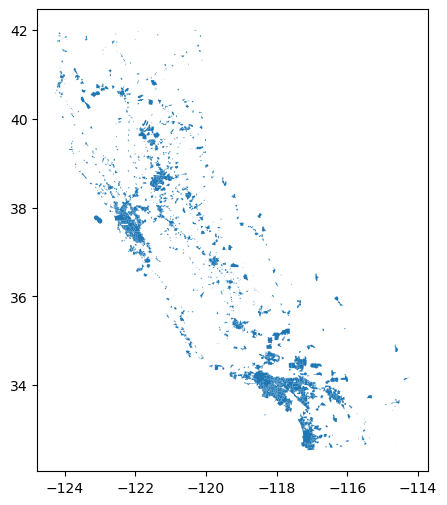

In [30]:
# Make a simple plot 
CAboundary.plot(figsize=(6, 6))
plt.show()

#### Mapping with folium

In [31]:
# centered based on the approximate lat/lon based on the map shows above
m = folium.Map(location=[34.0633, -117.6509], zoom_start=12, tiles='CartoDB positron')
m

In [32]:
# Map the boundary and region of cities in CA based on the CAboundary
for _, r in CAboundary.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed   
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)  #  Use the "gpd" (GeoPandas) library to simplify the geometry of each record and convert it to a GeoJSON format. 
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'orange'})
    folium.Popup(r['NAME']).add_to(geo_j)  # Shows the city names
    geo_j.add_to(m)
m

In [33]:
# Project to NAD83 projected crs
CAboundary = CAboundary.to_crs(epsg=2263)

# Access the centroid attribute of each polygon
# The "centroid" attribute is an inbuilt function in GeoPandas to calculate the centroid of a geometry.
CAboundary['centroid'] = CAboundary.centroid
CAboundary.head(2)

,STATEFP,PLACEFP,PLACENS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,PCICBSA,PCINECTA,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,centroid
0,06,66140,02411785,0666140,San Fernando,San Fernando city,25,C1,N,N,G4110,A,6148697,0,+34.2886519,-118.4362413,"POLYGON ((-11957905.646 1209740.166, -11957167...",POINT (-11951986.558 1208020.401)
1,06,14190,02409487,0614190,Cloverdale,Cloverdale city,25,C1,N,N,G4110,A,7863863,59201,+38.7959624,-123.0153700,"POLYGON ((-12283317.117 3310865.700, -12283148...",POINT (-12276751.541 3310647.058)


In [34]:
# Project to WGS84 geographic crs

# geometry (active) column
CAboundary = CAboundary.to_crs(epsg=4326)

# Centroid column
CAboundary['centroid'] = CAboundary['centroid'].to_crs(epsg=4326)

CAboundary.head()

,STATEFP,PLACEFP,PLACENS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,PCICBSA,PCINECTA,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,centroid
0,06,66140,02411785,0666140,San Fernando,San Fernando city,25,C1,N,N,G4110,A,6148697,0,+34.2886519,-118.4362413,"POLYGON ((-118.45602 34.28491, -118.45415 34.2...",POINT (-118.43625 34.28866)
1,06,14190,02409487,0614190,Cloverdale,Cloverdale city,25,C1,N,N,G4110,A,7863863,59201,+38.7959624,-123.0153700,"POLYGON ((-123.03513 38.78701, -123.03511 38.7...",POINT (-123.01521 38.79607)
2,06,16560,02410240,0616560,Cotati,Cotati city,25,C1,N,N,G4110,A,4869007,8380,+38.3284920,-122.7100491,"POLYGON ((-122.72961 38.33349, -122.72953 38.3...",POINT (-122.70916 38.32790)
3,06,65042,02411779,0665042,San Buenaventura (Ventura),San Buenaventura (Ventura) city,25,C1,Y,N,G4110,A,56500370,27033715,+34.2677796,-119.2542062,"MULTIPOLYGON (((-119.29712 34.34464, -119.2970...",POINT (-119.25443 34.26752)
4,06,30014,02410601,0630014,Glendora,Glendora city,25,C1,N,N,G4110,A,50251851,403066,+34.1449667,-117.8476672,"POLYGON ((-117.89111 34.14581, -117.89065 34.1...",POINT (-117.84656 34.14494)


In [35]:
for _, r in CAboundary.iterrows():
    lat = r['centroid'].y
    lon = r['centroid'].x
    folium.Marker(location=[lat, lon]),
    geo_j.add_to(m)

m

In [36]:
# Subset data of Ontario city 
Ontario = CAboundary[CAboundary['NAME'] == 'Ontario']
Ontario


,STATEFP,PLACEFP,PLACENS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,PCICBSA,PCINECTA,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,centroid
452,06,53896,02411323,0653896,Ontario,Ontario city,25,C1,Y,N,G4110,A,129329742,159101,+34.0394383,-117.6042147,"POLYGON ((-117.68347 34.05490, -117.68227 34.0...",POINT (-117.60643 34.03927)


<AxesSubplot: >

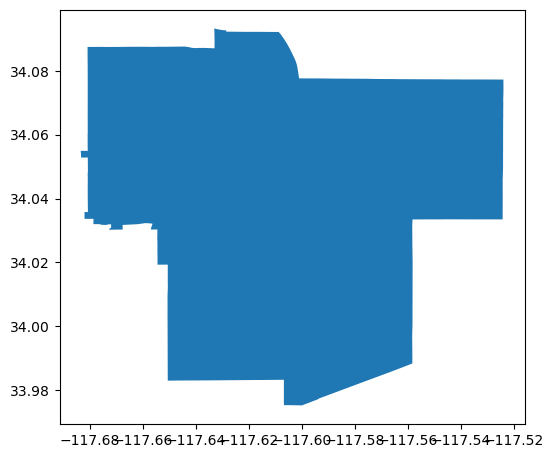

In [37]:
# plot it!
Ontario.plot(figsize=(6,6))

In [38]:
# Use WGS 84 (epsg:4326) as the geographic coordinate system
Ontario = Ontario.to_crs(epsg=4326)
Ontario.crs


<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [39]:
# Map the boundary and region of Ontario city based on the "Ontario" dataframe
for _, r in Ontario.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed 
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)  #  Use the "gpd" (GeoPandas) library to simplify the geometry of each record and convert it to a GeoJSON format.
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'blue'}) # Give it a different color
    folium.Popup(r['NAME']).add_to(geo_j)
    geo_j.add_to(m)
m

In [40]:
# Import the tracts jason file
tracts = gpd.read_file('https://raw.githubusercontent.com/rg-al/UP221-cargo/main/Data/censustracts.json')
tracts


,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry
0,06,009,000300,1400000US06009000300,06009000300,3,CT,457009794,394122,"POLYGON ((-120.75008 38.29765, -120.75042 38.2..."
1,06,011,000300,1400000US06011000300,06011000300,3,CT,952744514,195376,"POLYGON ((-122.47953 39.15804, -122.47824 39.1..."
2,06,013,303102,1400000US06013303102,06013303102,3031.02,CT,6507019,0,"POLYGON ((-121.71412 37.97147, -121.71409 37.9..."
3,06,013,303202,1400000US06013303202,06013303202,3032.02,CT,3725528,0,"POLYGON ((-121.72346 37.96161, -121.72534 37.9..."
4,06,013,303203,1400000US06013303203,06013303203,3032.03,CT,6354210,0,"POLYGON ((-121.74335 37.96151, -121.74425 37.9..."
...,...,...,...,...,...,...,...,...,...,...
8036,06,075,022902,1400000US06075022902,06075022902,229.02,CT,161833,0,"POLYGON ((-122.41205 37.75423, -122.41190 37.7..."
8037,06,065,044804,1400000US06065044804,06065044804,448.04,CT,2374766,248057,"POLYGON ((-116.51069 33.81593, -116.51068 33.8..."
8038,06,099,003300,1400000US06099003300,06099003300,33,CT,640784444,2596432,"POLYGON ((-121.47265 37.48217, -121.47297 37.4..."
8039,06,037,124400,1400000US06037124400,06037124400,1244,CT,961439,14163,"POLYGON ((-118.41379 34.17940, -118.41417 34.1..."


In [41]:
# Subset the census tracts of San Berdardino based on its county code "071"  
SanBetracts = tracts[tracts["COUNTYFP"] == '071']
SanBetracts

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry
268,06,071,009112,1400000US06071009112,06071009112,91.12,CT,4892473,0,"POLYGON ((-117.43466 34.51755, -117.43473 34.5..."
270,06,071,009713,1400000US06071009713,06071009713,97.13,CT,20049137,0,"POLYGON ((-117.19068 34.55689, -117.19046 34.5..."
271,06,071,009800,1400000US06071009800,06071009800,98,CT,3351493,0,"POLYGON ((-117.29516 34.54869, -117.30068 34.5..."
272,06,071,009912,1400000US06071009912,06071009912,99.12,CT,2821704,0,"POLYGON ((-117.32126 34.51319, -117.32275 34.5..."
273,06,071,010016,1400000US06071010016,06071010016,100.16,CT,5954851,0,"POLYGON ((-117.36884 34.44130, -117.37175 34.4..."
...,...,...,...,...,...,...,...,...,...,...
7905,06,071,007306,1400000US06071007306,06071007306,73.06,CT,3321196,0,"POLYGON ((-117.25417 34.05027, -117.25419 34.0..."
7928,06,071,008001,1400000US06071008001,06071008001,80.01,CT,4890513,0,"POLYGON ((-117.20029 34.09482, -117.20045 34.0..."
7975,06,071,002018,1400000US06071002018,06071002018,20.18,CT,2603039,0,"POLYGON ((-117.57574 34.15059, -117.59329 34.1..."
8028,06,071,006700,1400000US06071006700,06071006700,67,CT,1902343,0,"POLYGON ((-117.32711 34.07762, -117.32714 34.0..."


In [42]:
# Map the census tracts of San Berdarnido and layer it on to the map with city boundary
for _, r in SanBetracts.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'red'})
    folium.Popup(r['GEOID']).add_to(geo_j)
    geo_j.add_to(m)
m

In [43]:
# The census tracts of Ontario are shown by three layers. Now save their fips codes in "options" 
options = ['06071001903', '06071001906', '06071001905', '06071001703', '06071001804','06071001806','06071001808',
           '06071001809','06071002206','06071012700','06071001803','06071001810','06071001704','06071001702','06071001707',
           '06071001812','06071001813','06071001600','06071001001','06071001002','06071001101','06071001400','06071001501',
           '06071001503','06071001104','06071001706','06071000603','06071000304','06071001103','06071001200','06071001310',
           '06071001309','06071001305','06071001308','06071001312','06071002109','06071001504','06071001307'] 

# Subset the data based on options
Ontariotracts = SanBetracts[ SanBetracts['GEOID'].isin(options)] 

Ontariotracts

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry
435,06,071,001307,1400000US06071001307,06071001307,13.07,CT,1281879,0,"POLYGON ((-117.62857 34.09215, -117.62856 34.0..."
436,06,071,001703,1400000US06071001703,06071001703,17.03,CT,1909759,0,"POLYGON ((-117.66764 34.03029, -117.66760 34.0..."
437,06,071,001812,1400000US06071001812,06071001812,18.12,CT,888388,0,"POLYGON ((-117.65077 34.04925, -117.65074 34.0..."
717,06,071,001002,1400000US06071001002,06071001002,10.02,CT,1203162,0,"POLYGON ((-117.68082 34.07406, -117.68082 34.0..."
718,06,071,001310,1400000US06071001310,06071001310,13.10,CT,1417244,0,"POLYGON ((-117.64146 34.08708, -117.64144 34.0..."
719,06,071,001503,1400000US06071001503,06071001503,15.03,CT,553555,0,"POLYGON ((-117.63481 34.07071, -117.63481 34.0..."
720,06,071,001707,1400000US06071001707,06071001707,17.07,CT,1709523,0,"POLYGON ((-117.66979 34.04916, -117.66992 34.0..."
721,06,071,001810,1400000US06071001810,06071001810,18.10,CT,988342,0,"POLYGON ((-117.65071 34.03745, -117.65069 34.0..."
1627,06,071,001101,1400000US06071001101,06071001101,11.01,CT,791646,0,"POLYGON ((-117.67006 34.06878, -117.67006 34.0..."
2637,06,071,001308,1400000US06071001308,06071001308,13.08,CT,1077531,0,"POLYGON ((-117.61986 34.08490, -117.61980 34.0..."


In [44]:
# Layer the ontario tracts and make them popout 
for _, r in Ontariotracts.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'green'})
    folium.Popup(r['GEOID']).add_to(geo_j)
    geo_j.add_to(m)
m

In [45]:
# Define a new folium map
ontariom = folium.Map(location=[34.0633, -117.6509], zoom_start=12, tiles='CartoDB positron')
ontariom

In [46]:
# Map the Ontario boundary 
style = {'fillColor': '#00000000', 'color': '#00000000'}

for _, r in Ontario.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': style})
    folium.Popup(r['NAME']).add_to(geo_j)
    geo_j.add_to(ontariom)
ontariom

In [47]:
# Layer on the census tracts 
for _, r in Ontariotracts.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry']).simplify(tolerance=0.001)
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {'fillColor': 'green'})
    folium.Popup(r['GEOID']).add_to(geo_j)
    geo_j.add_to(ontariom)
ontariom

In [48]:
# Project to NAD83 projected crs
Ontariotracts = Ontariotracts.to_crs(epsg=2263)

# Access the centroid attribute of each polygon
Ontariotracts['centroid'] = Ontariotracts.centroid

In [49]:
# Project to WGS84 geographic crs

# geometry (active) column
Ontariotracts = Ontariotracts.to_crs(epsg=4326)

Ontariotracts['centroid'] = Ontariotracts['centroid'].to_crs(epsg=4326)

Ontariotracts.head()

,STATEFP,COUNTYFP,TRACTCE,AFFGEOID,GEOID,NAME,LSAD,ALAND,AWATER,geometry,centroid
435,06,071,001307,1400000US06071001307,06071001307,13.07,CT,1281879,0,"POLYGON ((-117.62857 34.09215, -117.62856 34.0...",POINT (-117.61987 34.08850)
436,06,071,001703,1400000US06071001703,06071001703,17.03,CT,1909759,0,"POLYGON ((-117.66764 34.03029, -117.66760 34.0...",POINT (-117.65914 34.02478)
437,06,071,001812,1400000US06071001812,06071001812,18.12,CT,888388,0,"POLYGON ((-117.65077 34.04925, -117.65074 34.0...",POINT (-117.64697 34.04290)
717,06,071,001002,1400000US06071001002,06071001002,10.02,CT,1203162,0,"POLYGON ((-117.68082 34.07406, -117.68082 34.0...",POINT (-117.67544 34.06876)
718,06,071,001310,1400000US06071001310,06071001310,13.10,CT,1417244,0,"POLYGON ((-117.64146 34.08708, -117.64144 34.0...",POINT (-117.63690 34.07806)


In [50]:
Ontariotracts.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 38 entries, 435 to 7701
Data columns (total 11 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   STATEFP   38 non-null     object  
 1   COUNTYFP  38 non-null     object  
 2   TRACTCE   38 non-null     object  
 3   AFFGEOID  38 non-null     object  
 4   GEOID     38 non-null     object  
 5   NAME      38 non-null     object  
 6   LSAD      38 non-null     object  
 7   ALAND     38 non-null     int64   
 8   AWATER    38 non-null     int64   
 9   geometry  38 non-null     geometry
 10  centroid  38 non-null     geometry
dtypes: geometry(2), int64(2), object(7)
memory usage: 3.6+ KB
